<h2 style='color:#09a2b3'> Video Analysis using Oracle AI Vision Service</h2>

In this demo we use **OCI Vision Service** to analyze images and videos. 

Using Object Detection techniques we're able to identify if frames are containing the logo of a company.

The video analyzed is one of the **Formula1 Video**

Notes: changed using **Resource Principal** Authentication

In [1]:
# info on the CONDA env used

# I have cloned the environment computervision_p37_cpu_v1
# and upgraded oci (for OCI Vision Client) with
# pip install -U oci
# this way oci is version 2.70.1
# the new environment is called: mycomputervision_p37_cpu

In [2]:
import oci
import torch

from oci.ai_vision import AIServiceVisionClient
from oci.ai_vision.models import AnalyzeImageDetails
from oci.ai_vision.models import ImageClassificationFeature
from oci.ai_vision.models import ImageObjectDetectionFeature
from oci.ai_vision.models import InlineImageDetails
from oci.ai_vision.models import ObjectStorageImageDetails

import os
import base64
import json
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import glob
from tqdm import tqdm
import seaborn as sns

from IPython.display import Video

sns.set()

%matplotlib inline

In [3]:
# dobbiamo usare una versione specifica di OCI SDK
print(f"CV2 version is: {cv2.__version__}")
print(f"PyTorch version is: {torch.__version__}")
print(f"OCI version is: {oci.__version__}")

CV2 version is: 4.5.3
PyTorch version is: 1.10.0
OCI version is: 2.70.1


### Configuration

In [29]:
# cambiato in modo da usare RP. config is set to {}
rps = oci.auth.signers.get_resource_principals_signer()

# Max Result to return
MAX_RESULTS = 5

# logos for which I want to analyze
logos_list = ['Mobil', 'Oracle', 'RedBull']

# color map for logos
label_map = {}
# the label returned from OCI Visio is Mobil1 and not Mobil
label_map["Mobil1"] = [169, 23, 69] # blue
label_map["Oracle"] = [64, 57, 144] # red [169, 23, 69]
label_map["RedBull"] = [112, 168, 162] # green
label_map["Siemens"] = [169, 10, 60] # ?

# Vision Service endpoint
ENDPOINT = "https://vision.aiservice.eu-frankfurt-1.oci.oraclecloud.com"
# the custom trained model we're using for Object Detection
#MODEL_ID = "ocid1.aivisionmodel.oc1.eu-frankfurt-1.amaaaaaangencdyarrrcfnwo2yly3goldt4zwvvcs2bkerzwfrbntli74sta"
# new model, july 2022
MODEL_ID = "ocid1.aivisionmodel.oc1.eu-frankfurt-1.amaaaaaangencdyaeecdamgkvfvmv2ds6yhjis4vepqtyyjeavbajx4meszq"

# Initialize client service_endpoint is optional if it's specified in config
ai_service_vision_client = AIServiceVisionClient(config={}, service_endpoint=ENDPOINT, signer=rps)

In [6]:
list_models = ai_service_vision_client.list_models(compartment_id="ocid1.compartment.oc1..aaaaaaaahioj3gxhxpebugaocrtfbb25yramvyfs4ah2prmhnf2adovtmp6a")

list_models.data

{
  "items": [
    {
      "compartment_id": "ocid1.compartment.oc1..aaaaaaaahioj3gxhxpebugaocrtfbb25yramvyfs4ah2prmhnf2adovtmp6a",
      "defined_tags": {
        "default-tags": {
          "CreatedBy": "oracleidentitycloudservice/luigi.saetta@oracle.com"
        }
      },
      "description": "with all the dataset labeld + some corrections to existing images",
      "display_name": "logo_new_luigi4",
      "freeform_tags": {},
      "id": "ocid1.aivisionmodel.oc1.eu-frankfurt-1.amaaaaaangencdyaeecdamgkvfvmv2ds6yhjis4vepqtyyjeavbajx4meszq",
      "lifecycle_details": null,
      "lifecycle_state": "ACTIVE",
      "model_type": "OBJECT_DETECTION",
      "model_version": "version",
      "precision": 0.9886364,
      "project_id": "ocid1.aivisionproject.oc1.eu-frankfurt-1.amaaaaaangencdyaiens6qiaablagzi5qogxrmxlvjhp42vevrtz4sy67fdq",
      "system_tags": {},
      "testing_dataset": null,
      "time_created": "2022-06-30T13:46:43.903000+00:00",
      "time_updated": "2022-06-30T18:04

### Utility Functions

In [22]:
# plot the image using pyplot
def plot_image(img):
    height, width, channels = im.shape
    fig = plt.figure()
    
    # a way to set the size
    fig.set_size_inches(width/50, height/50)

    # Plot the Image
    plt.imshow(img)
    plt.grid(False);
    
#
# analyze a single frame and returns the list of logos identified
# as input: the file name
# as output the list with names of logos
#
def analyze_single_image(f_name):
    #
    # as input the file name
    #
    with open(f_name, "rb") as image_file:
        # we need to send as base64, UTF8
        encoded_string = base64.b64encode(image_file.read()).decode('utf-8')
    
    image_object_detection_feature = ImageObjectDetectionFeature()
    image_object_detection_feature.max_results = MAX_RESULTS

    # this is the ID of our custom model
    image_object_detection_feature.model_id = MODEL_ID

    # List of Features
    features = [image_object_detection_feature]

    # Create Analyze Image Object and set Image and Features
    analyze_image_details = AnalyzeImageDetails()
    inline_image_details = InlineImageDetails()

    inline_image_details.data = encoded_string
    analyze_image_details.image = inline_image_details
    analyze_image_details.features = features

    # Send analyze image request to Vision Service
    res = ai_service_vision_client.analyze_image(analyze_image_details=analyze_image_details)
    
    # transform in JSON
    od_results = json.loads(str(res.data))
    
    od_bounding_boxes = od_results['image_objects']
    
    list_logos = []
    
    if od_bounding_boxes is not None:
        for box in od_bounding_boxes:
            list_logos.append(box['name'])
    else:
        list_logos.append("")
        
    # to sort and remove duplicates
    list_logos = sorted(list(set(list_logos)))
    
    return list_logos

#
# compute and plot the temporal profile
#
def compute_temporal_profile(df, logo):
    # split the DataFrame in 10 buckets and compute how many times
    # the logo is present in each buckets
    N_BUCKETS = 10
    
    n_el = df.shape[0]
    w_size = int(n_el/N_BUCKETS)
    
    l_counts = []
    
    for b_num in range(N_BUCKETS):
        w_start = b_num * w_size
        w_end = w_start + w_size
        
        # handle last window
        if (w_end > n_el):
            w_end = n_el
        
        n_counts = sum(df[logo][w_start:w_end])
        
        l_counts.append(n_counts)
        
    return l_counts

def plot_profile(profile, logo):
    plt.title("Temporal profile for " + logo)
    plt.xlabel("Time slot")
    plt.ylabel("# of times")
    plt.ylim([0, 40])
    plt.bar(x=range(1, len(profile)+1), height=profile, align='center', width=1)
    
LOGO = "Oracle"

def logos_contains(txt):
    v_rit = False
    if LOGO in txt:
        v_rit = True
    
    return v_rit

#
#
#add the BB to a single image
###
def add_bb_single_image(f_name):
    # threshold for confidence
    THRESHOLD = 0.6
    #
    # as input the file name
    #
    with open(f_name, "rb") as image_file:
        # we need to send as base64, UTF8
        encoded_string = base64.b64encode(image_file.read()).decode('utf-8')
    
    image_object_detection_feature = ImageObjectDetectionFeature()
    image_object_detection_feature.max_results = MAX_RESULTS

    # this is the ID of our custom model
    image_object_detection_feature.model_id = MODEL_ID

    # List of Features
    features = [image_object_detection_feature]

    # Create Analyze Image Object and set Image and Features
    analyze_image_details = AnalyzeImageDetails()
    inline_image_details = InlineImageDetails()

    inline_image_details.data = encoded_string
    analyze_image_details.image = inline_image_details
    analyze_image_details.features = features

    # Send analyze image request to Vision Service
    res = ai_service_vision_client.analyze_image(analyze_image_details=analyze_image_details)
    
    od_results = json.loads(str(res.data))
    
    od_bounding_boxes = od_results['image_objects']
    
    # get the BB
    im = cv2.imread(f_name)

    # Get Dimensions of Image
    height, width, channels = im.shape
    
    if od_bounding_boxes is not None:
    # Iterate over each Bounding Box
        for box in od_bounding_boxes:
            if box['confidence'] >= THRESHOLD:
                # draw
                # Extract opposite coordinates for bounding box
                # Un-Normalise the Data by scaling to the max image height and width
                # Convert to Integer
                coordinates_pt1_x = int(box['bounding_polygon']['normalized_vertices'][0]['x'] * width)
                coordinates_pt1_y = int(box['bounding_polygon']['normalized_vertices'][0]['y'] * height)
                coordinates_pt2_x = int(box['bounding_polygon']['normalized_vertices'][2]['x'] * width)
                coordinates_pt2_y = int(box['bounding_polygon']['normalized_vertices'][2]['y'] * height)
    
                # Build Points as Tuples
                coordinates_pt1 = (coordinates_pt1_x, coordinates_pt1_y)
                coordinates_pt2 = (coordinates_pt2_x, coordinates_pt2_y)
    
                # Draw Bounding Boxes - Pass in Image, Top Left and Bottom Right Points, Colour, Line Thickness
                cv2.rectangle(im, coordinates_pt1, coordinates_pt2, label_map[box['name']], 4)
                # Plot Label just above the Top Left Point, Set Font, Size, Colour, Thickness
                cv2.putText(im, box['name'], (coordinates_pt1_x, coordinates_pt1_y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,0), 2)
    
    # return the image with all BBs added
    return im

### Test with one image

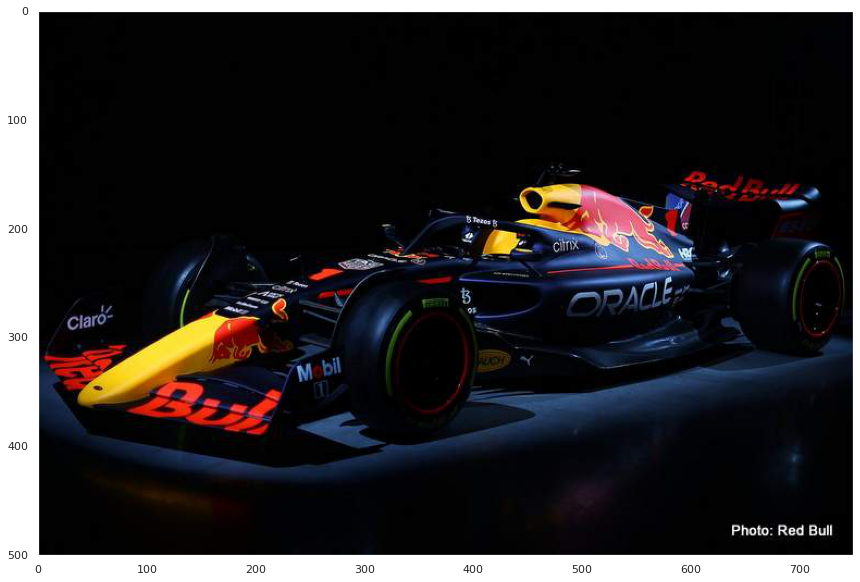

In [8]:
# prepare the image
# A sample image
IMAGE = "./oracle_red_bull2.jpg"

# Let's see the image
im = cv2.imread(IMAGE)

# we need this since cv2 use BGR and pyplot use RGB
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)

plot_image(im)

#### Prepare and do the call to AI Vision Service

In [9]:
%%time

# Open Image as Base64 encoded String (it is base64 since must be sent in a REST call)
with open(IMAGE, "rb") as image_file:
    # we need to send as base64, UTF8
    encoded_string = base64.b64encode(image_file.read()).decode('utf-8')
    
# Set up request body with one or multiple Features (Type of Service)
image_object_detection_feature = ImageObjectDetectionFeature()
image_object_detection_feature.max_results = MAX_RESULTS

# this is the ID of our custom model
image_object_detection_feature.model_id = MODEL_ID

# List of Features
features = [image_object_detection_feature]

# Create Analyze Image Object and set Image and Features
analyze_image_details = AnalyzeImageDetails()
inline_image_details = InlineImageDetails()

inline_image_details.data = encoded_string
analyze_image_details.image = inline_image_details
analyze_image_details.features = features

# Send analyze image request to Vision Service
print("Calling AI Vision Service...")
res = ai_service_vision_client.analyze_image(analyze_image_details=analyze_image_details)

Calling AI Vision Service...
CPU times: user 12.9 ms, sys: 2.08 ms, total: 15 ms
Wall time: 1.26 s


In [10]:
# have a look at result

# transform in JSON
od_results = json.loads(str(res.data))

od_results['image_objects']

[{'bounding_polygon': {'normalized_vertices': [{'x': 0.6626666666666666,
     'y': 0.48303393213572854},
    {'x': 0.776, 'y': 0.48303393213572854},
    {'x': 0.776, 'y': 0.5728542914171657},
    {'x': 0.6626666666666666, 'y': 0.5728542914171657}]},
  'confidence': 0.91960555,
  'name': 'Oracle'},
 {'bounding_polygon': {'normalized_vertices': [{'x': 0.316,
     'y': 0.6367265469061876},
    {'x': 0.37866666666666665, 'y': 0.6367265469061876},
    {'x': 0.37866666666666665, 'y': 0.6766467065868264},
    {'x': 0.316, 'y': 0.6766467065868264}]},
  'confidence': 0.5756958,
  'name': 'Mobil1'},
 {'bounding_polygon': {'normalized_vertices': [{'x': 0.20266666666666666,
     'y': 0.5768463073852296},
    {'x': 0.2906666666666667, 'y': 0.5768463073852296},
    {'x': 0.2906666666666667, 'y': 0.6427145708582834},
    {'x': 0.20266666666666666, 'y': 0.6427145708582834}]},
  'confidence': 0.15007044,
  'name': 'RedBull'}]

#### Analyze and display the results 

In [11]:
# Print result
print("*** Results of Image Analysis ***\n")

# Extract Bounding Boxes from results
od_bounding_boxes = od_results['image_objects']

# Create Empty DataFrame for display
results_df = pd.DataFrame([], columns = ["Label", "Confidence"])

# create the sorted list of logos in the image
list_logos = []

for box in od_bounding_boxes:
    list_logos.append(box['name'])
    
# remove duplicates and sort
list_logos = sorted(list(set(list_logos)))

# Iterate over each Bounding Box
for box in od_bounding_boxes:
    
    # Extract Label and Confidence
    results_list = [box['name'], box['confidence']]
    
    # Append to Results DataFrame
    a_series = pd.Series(results_list, index = results_df.columns)
    results_df = results_df.append(a_series, ignore_index=True)

# Summary of results
print("Logos identified: ", list_logos)
print()

# Print Label & Confidence DF    
results_df.head(10)

*** Results of Image Analysis ***

Logos identified:  ['Mobil1', 'Oracle', 'RedBull']



,Label,Confidence
0,Oracle,0.919606
1,Mobil1,0.575696
2,RedBull,0.150070


#### Display the image with BB rectangles

In [12]:
# Read the Image to draw the BB
im = cv2.imread(IMAGE)

# Get Dimensions of Image
height, width, channels = im.shape

# Iterate over each Bounding Box
for box in od_bounding_boxes:
    
    # Extract opposite coordinates for bounding box
    # Un-Normalise the Data by scaling to the max image height and width
    # Convert to Integer
    coordinates_pt1_x = int(box['bounding_polygon']['normalized_vertices'][0]['x'] * width)
    coordinates_pt1_y = int(box['bounding_polygon']['normalized_vertices'][0]['y'] * height)
    coordinates_pt2_x = int(box['bounding_polygon']['normalized_vertices'][2]['x'] * width)
    coordinates_pt2_y = int(box['bounding_polygon']['normalized_vertices'][2]['y'] * height)
    
    # Build Points as Tuples
    coordinates_pt1 = (coordinates_pt1_x, coordinates_pt1_y)
    coordinates_pt2 = (coordinates_pt2_x, coordinates_pt2_y)
    
    # Draw Bounding Boxes - Pass in Image, Top Left and Bottom Right Points, Colour, Line Thickness
    cv2.rectangle(im, coordinates_pt1, coordinates_pt2, label_map[box['name']], 2)
    # Plot Label just above the Top Left Point, Set Font, Size, Colour, Thickness
    cv2.putText(im, box['name'], (coordinates_pt1_x, coordinates_pt1_y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,0), 2)

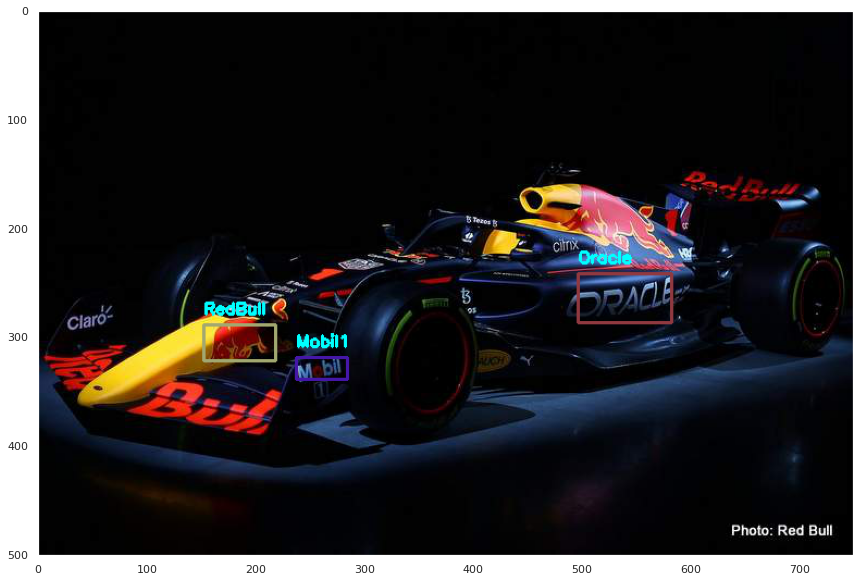

In [13]:
# plot the image with BB
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)

plot_image(im)

### Analyze a batch of images

In [14]:
#
# Analyze a list of images
#
file_names_list = sorted(glob.glob("*.jpg"))

all_logos_list = []

for f_name in file_names_list:
    logo_list = analyze_single_image(f_name)
    
    logo_str = ','.join([str(item) for item in logo_list])
    all_logos_list.append(logo_str)

#
# create and shows the results dataframe
#
df_dict = {"fname": file_names_list, "logos": all_logos_list}
df = pd.DataFrame(df_dict)

print()
print(f"Analyzed {len(file_names_list)} images. The result is:")
print()
display(df)


Analyzed 4 images. The result is:



,fname,logos
0,oracle1.jpg,"Mobil1,Oracle,RedBull"
1,oracle2.jpg,"Oracle,RedBull"
2,oracle_red_bull1.jpg,"Mobil1,Oracle,RedBull"
3,oracle_red_bull2.jpg,"Mobil1,Oracle,RedBull"


<h2 style='color:#09a2b3'> Analyze a Video</h2>

#### Extract all frames from the Video using CV2

In [15]:
# have a look at the Video

VIDEO_FILE = "./max_lewis_short.mp4"

Video(VIDEO_FILE, embed=True)

#### Some general info on the Video

In [16]:
# Read the video from specified path 
cam = cv2.VideoCapture(VIDEO_FILE)

# get fps
fps = int(cam.get(cv2.CAP_PROP_FPS))

# get the total number of frames
tot_frames = int(cam.get(cv2.CAP_PROP_FRAME_COUNT))

duration = round(tot_frames/fps, 1)

print(f"Il video ha una durata di {duration} sec.")
print(f"Il numero di frames per sec. è: {fps}")
print(f"Il numero totale di frames è: {tot_frames}")

Il video ha una durata di 10.8 sec.
Il numero di frames per sec. è: 30
Il numero totale di frames è: 323


In [17]:
%%time 

path_split_images = "./split_images" 

if not os.path.exists(path_split_images):         
    os.makedirs(path_split_images) 
        
# Read the video from specified path 
cam = cv2.VideoCapture(VIDEO_FILE)

n_frames = 0

ret, frame = cam.read() 

with tqdm(total=tot_frames, colour="blue") as pbar:
    while(ret): 
        n_frames += 1
    
        # build the file name
        f_name = "img{:05d}.jpg".format(n_frames)
    
        cv2.imwrite("./split_images" + "/" + f_name, frame)
        
        pbar.update(1)
        
        # reading next frame 
        ret, frame = cam.read() 
    
cam.release() 
cv2.destroyAllWindows()

print()
print(f"Total number of frames: {n_frames}")

100%|██████████| 323/323 [00:24<00:00, 13.09it/s]



Total number of frames: 323
CPU times: user 27.9 s, sys: 373 ms, total: 28.3 s
Wall time: 24.8 s


#### Analyze all the frames

In [18]:
%%time

file_names_list = sorted(glob.glob("./split_images/*.jpg"))

all_logos_list = []

with tqdm(total=tot_frames, colour="blue") as pbar:
    for f_name in file_names_list:
        # call API
        logo_list = analyze_single_image(f_name)
    
        logo_str = ','.join([str(item) for item in logo_list])
        all_logos_list.append(logo_str)
        
        pbar.update(1)

#
# create and shows the results dataframe
#
df_dict = {"fname": file_names_list, "logos": all_logos_list}
df = pd.DataFrame(df_dict)

print()
print(f"Analyzed {len(file_names_list)} images. The result is:")
print()
display(df)

100%|██████████| 323/323 [05:18<00:00,  1.01it/s]


Analyzed 323 images. The result is:



,fname,logos
0,./split_images/img00001.jpg,Oracle
1,./split_images/img00002.jpg,Oracle
2,./split_images/img00003.jpg,
3,./split_images/img00004.jpg,
4,./split_images/img00005.jpg,
...,...,...
318,./split_images/img00319.jpg,"Oracle,RedBull"
319,./split_images/img00320.jpg,"Oracle,RedBull"
320,./split_images/img00321.jpg,RedBull
321,./split_images/img00322.jpg,RedBull


CPU times: user 4.77 s, sys: 322 ms, total: 5.1 s
Wall time: 5min 18s


<h4 style='color:#09a2b3'> Compute the fraction of the video containing the logo</h4>

In [30]:
# compute fraction

# it is used to add Others without dirting logos_list
all_logos_list = logos_list.copy()

for LOGO in logos_list:
    df[LOGO] = df['logos'].apply(logos_contains)
    
tot_frames = df.shape[0]

frac_list = []

for LOGO in logos_list:
    tot_containing = df[LOGO].sum()
    frac = round(float(tot_containing)*100./float(tot_frames), 1)

    # print(f"The fraction of video containing the logo {LOGO} is: {frac}%")
    frac_list.append(frac)

# add the last part
tot_found = sum(frac_list)
all_logos_list.append("Others")
frac_list.append(100. - tot_found)

df_dict_frac = {"logo":all_logos_list, "fraction %": frac_list}

df_frac = pd.DataFrame(df_dict_frac, index=all_logos_list)

df_frac.head()

,logo,fraction %
Mobil,Mobil,8.0
Oracle,Oracle,46.4
RedBull,RedBull,19.5
Others,Others,26.1


#### Pie plot

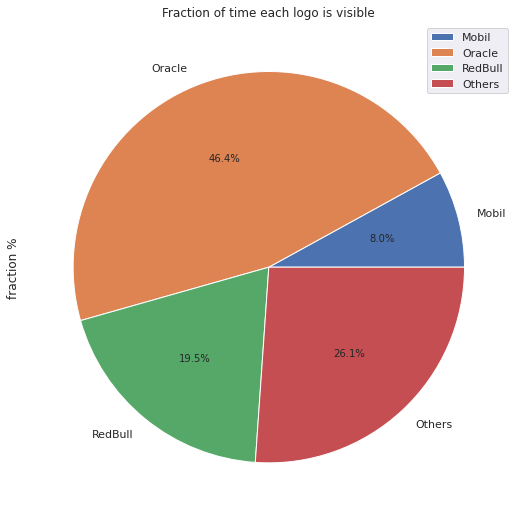

In [20]:
df_frac.plot(x="logo", y="fraction %", figsize=(9,9), kind="pie", autopct='%1.1f%%', title="Fraction of time each logo is visible")
plt.show();

<h4 style='color:#09a2b3'> and the Temporal Profile</h4>

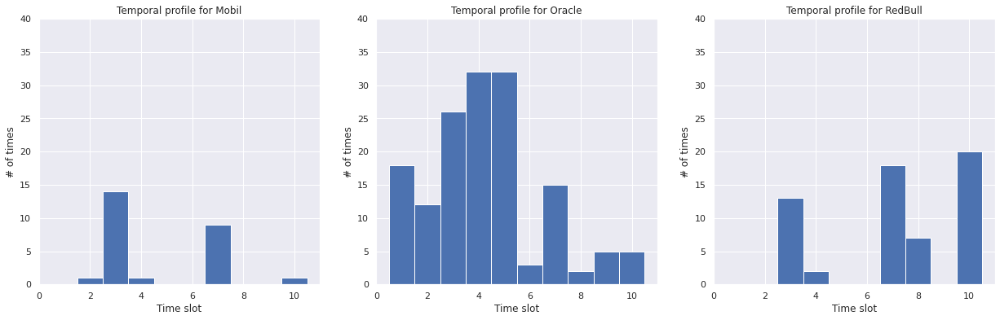

In [23]:
N_ROWS = 1
N_COLS = 3

plt.figure(figsize=(21, 6))

for i, logo in enumerate(logos_list):
    profile = compute_temporal_profile(df, logo)
    plt.subplot(N_ROWS, N_COLS, i+1)
    plot_profile(profile, logo)
    
plt.show()

In [24]:
# calcola l'intervallo di massima visibilità

n_segs = 10
seg_duration = duration/n_segs

list_slot = []

for i, logo in enumerate(logos_list):
    # compute temporal profile mi dice quanti frame con quel logo per ogni slot
    profile = compute_temporal_profile(df, logo)
    # trovo lo slot di massima presenza
    id_max = np.argmax(np.array(profile))
    # calcolo start-end (in sec. dello slot)
    seg_start =  round(id_max * seg_duration, 1)
    seg_end = round((id_max + 1) * seg_duration, 1)
    
    # costruico la stringa da visualizzare
    slot = str(seg_start) + "-" + str(seg_end)
    
    list_slot.append(slot)

# aggiorna il dataframe
# devo mettere un null per "Others"
list_slot.append("-")
df_frac['intervallo_max_visib.'] = list_slot

display(df_frac)

,logo,fraction %,intervallo_max_visib.
Mobil,Mobil,8.0,2.2-3.2
Oracle,Oracle,46.4,3.2-4.3
RedBull,RedBull,19.5,9.7-10.8
Others,Others,26.1,-


####  Some utility functions to build the video

In [42]:
im_with_bb = add_bb_single_image("oracle1.jpg")

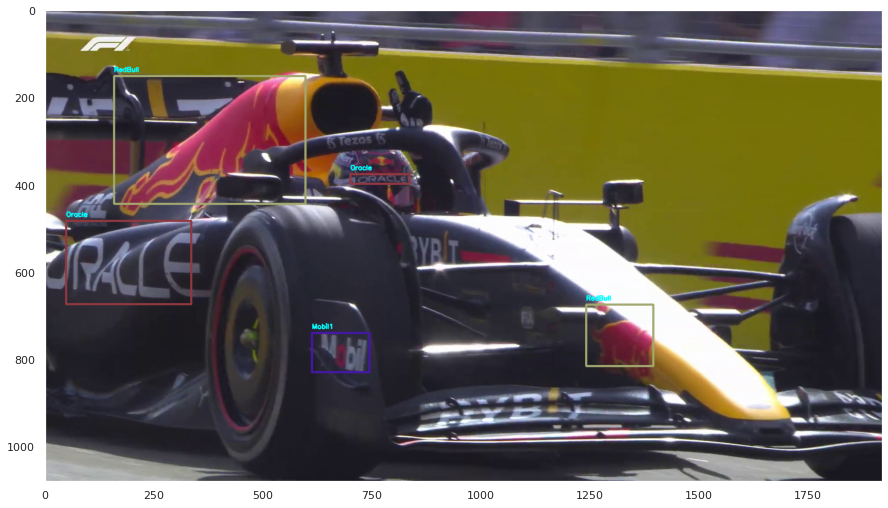

In [43]:
im_with_bb = cv2.cvtColor(im_with_bb, cv2.COLOR_BGR2RGB)

plot_image(im_with_bb)

<h3 style='color:#09a2b3'> Create a Video displaying BB rectangles</h3>

In [27]:
# in this dir we will put all images with BB
path_split_images_bb = "./split_images_bb"

if not os.path.exists(path_split_images_bb):         
    os.makedirs(path_split_images_bb)

In [31]:
file_names_list = sorted(glob.glob("./split_images/*.jpg"))

with tqdm(total=len(file_names_list), colour="blue") as pbar:
    for f_name in file_names_list:
        # call API
        im_with_bb = add_bb_single_image(f_name)
        
        new_name = f_name.split("/")[-1].split(".")[0] + "_bb.jpg"
        
        cv2.imwrite("./split_images_bb" + "/" + new_name, im_with_bb)
        
        pbar.update(1)

100%|██████████| 323/323 [05:35<00:00,  1.04s/it]


In [32]:
# now let's create a new video with BBs

NEW_VIDEO_NAME = "video_bb.mp4"

# take a sample image
img = cv2.imread(file_names_list[0])
height, width, layers = img.shape

# H264 is crucial to be able to display in this NB
video = cv2.VideoWriter(NEW_VIDEO_NAME,fourcc=cv2.VideoWriter_fourcc(*'H264'), fps=fps, frameSize=(width,height)) 
 
with tqdm(total=len(file_names_list), colour="blue") as pbar:
    for f_name in sorted(glob.glob("./split_images_bb/*.jpg")):
        img = cv2.imread(f_name)
        
        video.write(img)

        pbar.update(1)


video.release()

100%|██████████| 323/323 [00:25<00:00, 12.82it/s]


In [33]:
# il video non contiene audio
Video(NEW_VIDEO_NAME, embed=True)